## Import Modules

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

## Load the files

In [2]:
# BASE_DIR = '/kaggle/input/anime-faces/data/'
BASE_DIR ='./animefacedataset'

In [3]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [4]:
image_paths[:5]

['./animefacedataset\\1.png',
 './animefacedataset\\10.png',
 './animefacedataset\\100.png',
 './animefacedataset\\1000.png',
 './animefacedataset\\10000.png']

In [5]:
# remove unnecessary file
# image_paths.remove('/kaggle/input/anime-faces/data/data')

In [6]:
len(image_paths)

21551

## Visualize the Image Dataset

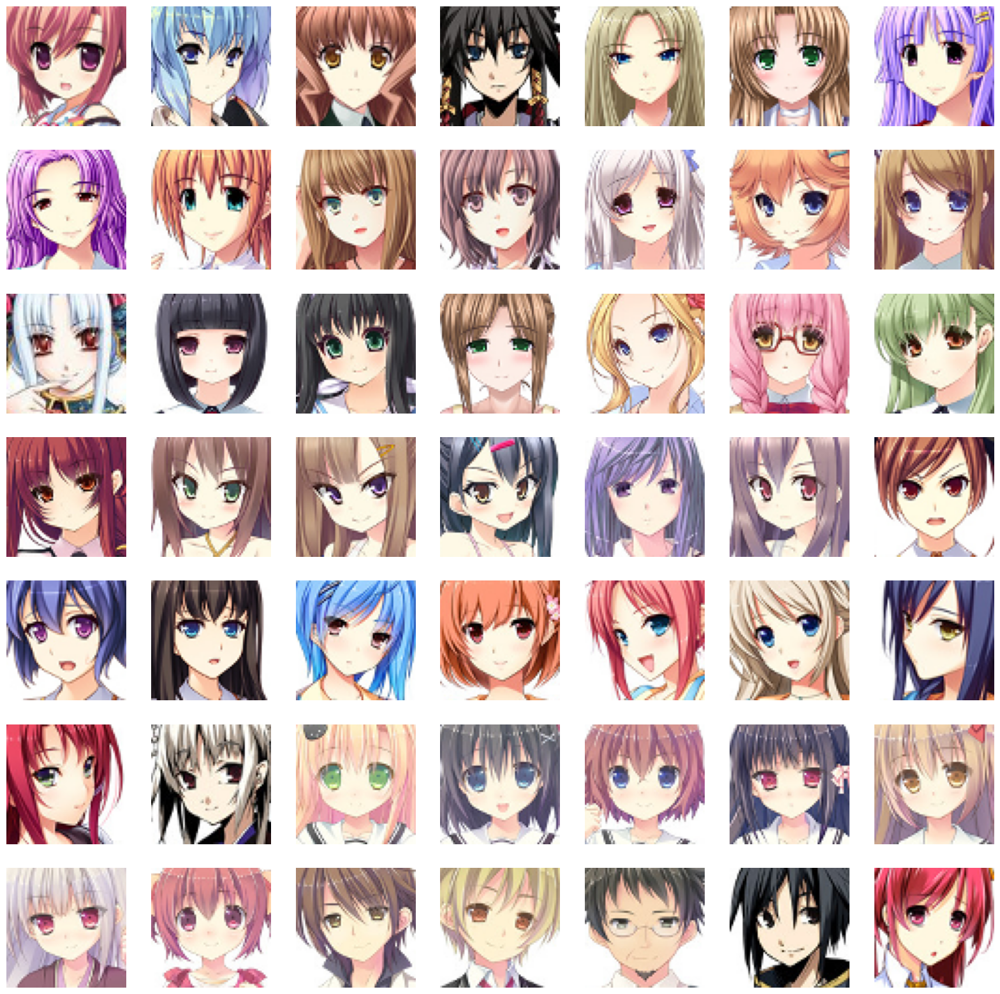

In [7]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

## Preprocess Images

In [8]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [9]:
train_images[0].shape

(64, 64, 3)

In [10]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [11]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [12]:
train_images[0]

array([[[ 0.94509804,  0.42745098,  0.24705882],
        [ 0.96862745,  0.44313726,  0.33333334],
        [ 0.9529412 ,  0.5058824 ,  0.35686275],
        ...,
        [ 0.38039216, -0.38039216, -0.19215687],
        [ 0.43529412, -0.34117648, -0.15294118],
        [ 0.49019608, -0.1764706 , -0.02745098]],

       [[ 0.90588236,  0.43529412,  0.23137255],
        [ 0.92941177,  0.43529412,  0.3254902 ],
        [ 0.9529412 ,  0.44313726,  0.35686275],
        ...,
        [ 0.33333334, -0.3647059 , -0.19215687],
        [ 0.39607844, -0.37254903, -0.16862746],
        [ 0.35686275, -0.3647059 , -0.19215687]],

       [[ 0.8980392 ,  0.4117647 ,  0.2627451 ],
        [ 0.96862745,  0.4745098 ,  0.33333334],
        [ 0.75686276,  0.14509805,  0.16078432],
        ...,
        [ 0.40392157, -0.31764707, -0.12156863],
        [ 0.38039216, -0.37254903, -0.16078432],
        [ 0.35686275, -0.40392157, -0.20784314]],

       ...,

       [[ 1.        ,  1.        ,  1.        ],
        [ 1

## Create Generator & Discriminator Models

In [13]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

### Generator Model

Generator Model will create new images similar to training data from random noise

In [14]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 32768)               │       3,309,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu (ReLU)                         │ (None, 32768)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_1 (ReLU)                       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_2 (ReLU)                       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 64, 64, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_3 (ReLU)                       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 64, 64, 3)           │           3,075 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

### Discriminator Model

Discriminator model will classify the image from the generator to check whether it real (or) fake images.

In [15]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)                    │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 8, 8, 128)           │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │           8,193 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

## Create DCGAN

In [16]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        
    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]
    
    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            
            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2
            
        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
        
        
        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)
            
        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        
        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [17]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()
        
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()
        
    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [18]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [19]:
D_LR = 0.0001 
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 1.3205 - g_loss: 1.8743

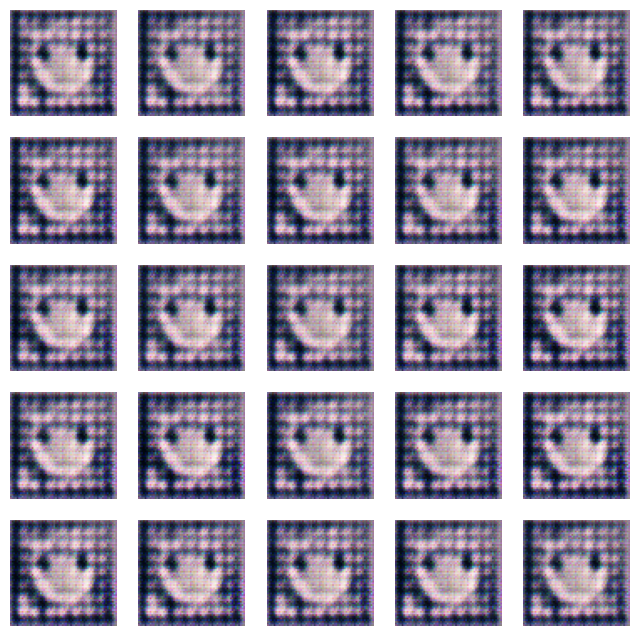

674/674 ━━━━━━━━━━━━━━━━━━━━ 857s 1s/step - d_loss: 1.3196 - g_loss: 1.8755
Epoch 2/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5676 - g_loss: 1.9914

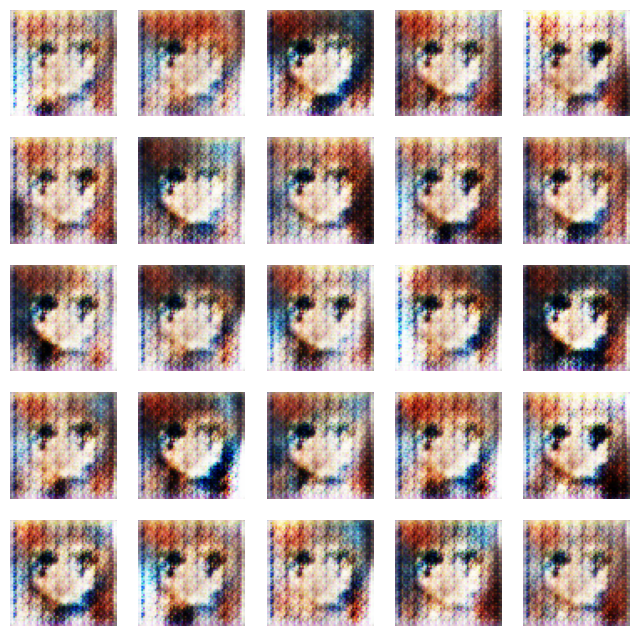

674/674 ━━━━━━━━━━━━━━━━━━━━ 844s 1s/step - d_loss: 0.5676 - g_loss: 1.9912
Epoch 3/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5705 - g_loss: 1.8302

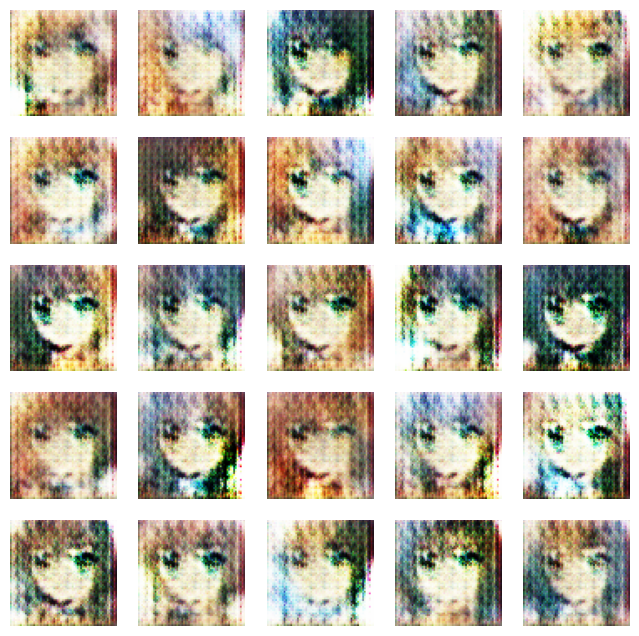

674/674 ━━━━━━━━━━━━━━━━━━━━ 813s 1s/step - d_loss: 0.5705 - g_loss: 1.8301
Epoch 4/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5798 - g_loss: 1.7902

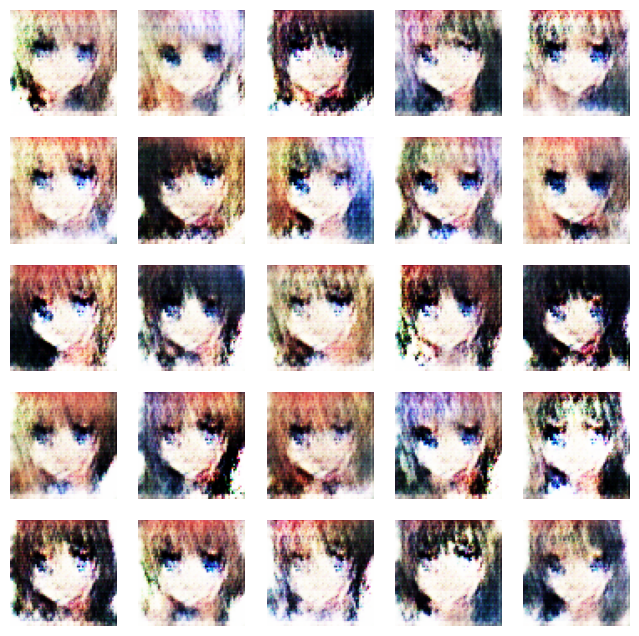

674/674 ━━━━━━━━━━━━━━━━━━━━ 871s 1s/step - d_loss: 0.5798 - g_loss: 1.7902
Epoch 5/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5795 - g_loss: 1.6996

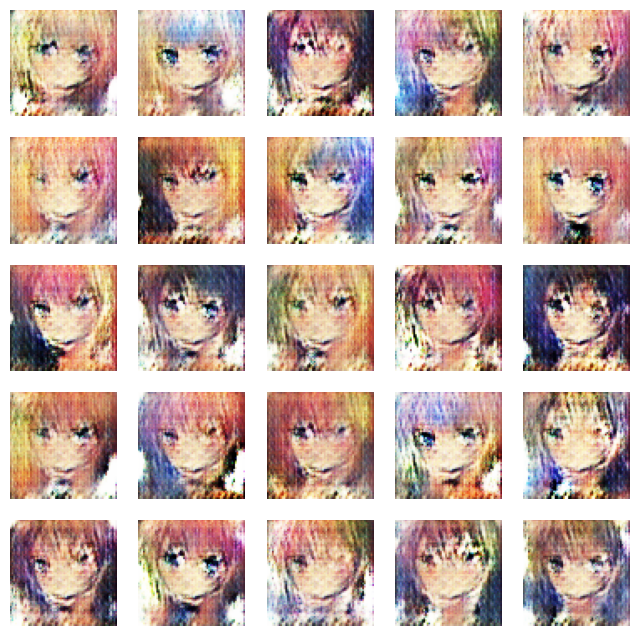

674/674 ━━━━━━━━━━━━━━━━━━━━ 783s 1s/step - d_loss: 0.5795 - g_loss: 1.6996
Epoch 6/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5736 - g_loss: 1.7006

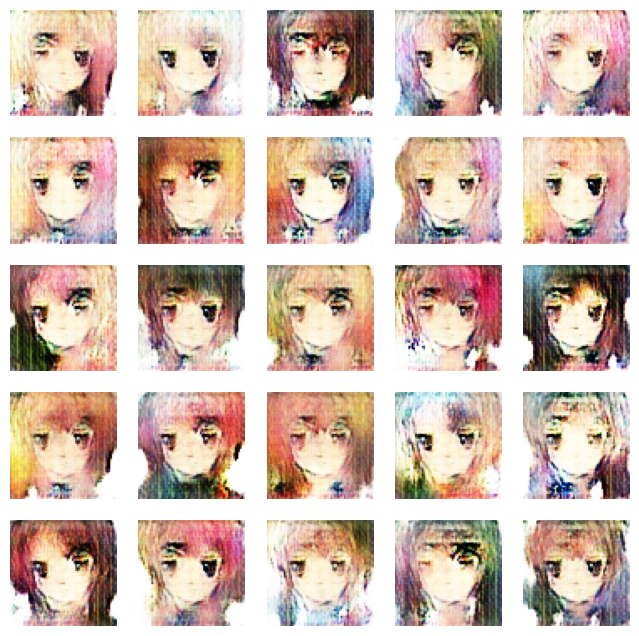

674/674 ━━━━━━━━━━━━━━━━━━━━ 780s 1s/step - d_loss: 0.5736 - g_loss: 1.7007
Epoch 7/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5517 - g_loss: 1.6951

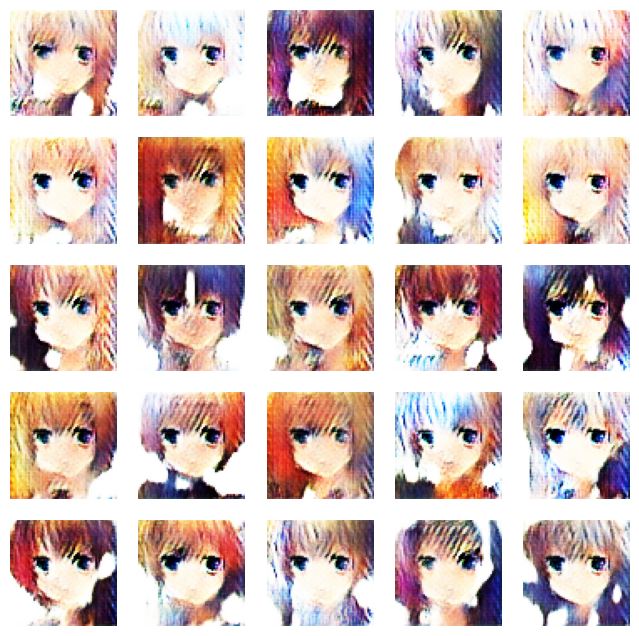

674/674 ━━━━━━━━━━━━━━━━━━━━ 782s 1s/step - d_loss: 0.5517 - g_loss: 1.6951
Epoch 8/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5287 - g_loss: 1.8267

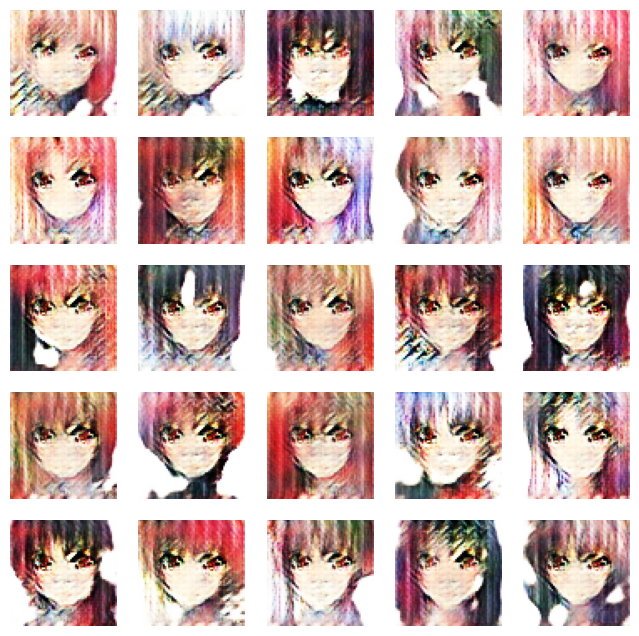

674/674 ━━━━━━━━━━━━━━━━━━━━ 775s 1s/step - d_loss: 0.5287 - g_loss: 1.8267
Epoch 9/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5312 - g_loss: 1.7699

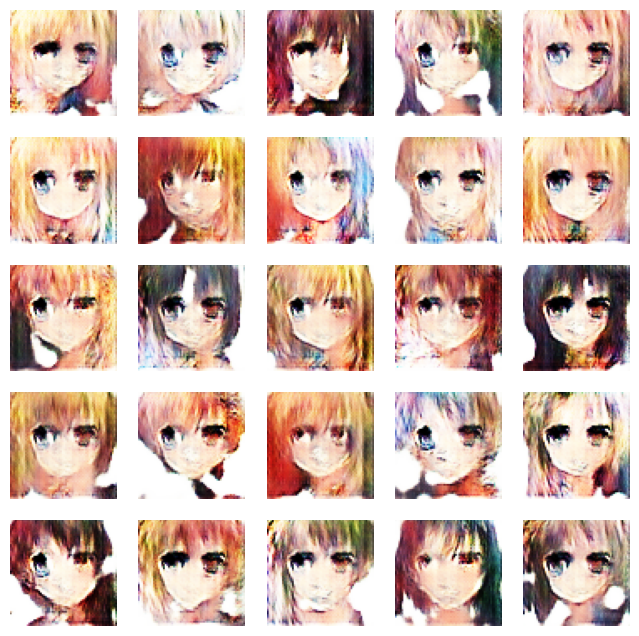

674/674 ━━━━━━━━━━━━━━━━━━━━ 811s 1s/step - d_loss: 0.5312 - g_loss: 1.7698
Epoch 10/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5662 - g_loss: 1.5650

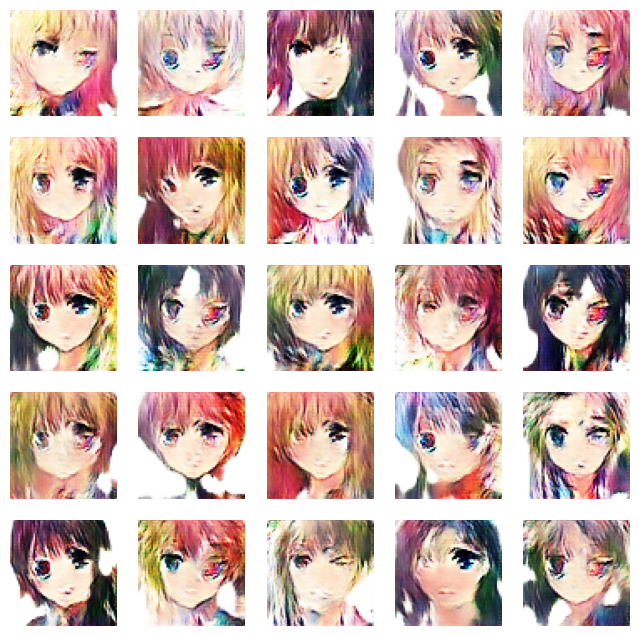

674/674 ━━━━━━━━━━━━━━━━━━━━ 782s 1s/step - d_loss: 0.5662 - g_loss: 1.5649
Epoch 11/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6097 - g_loss: 1.3189

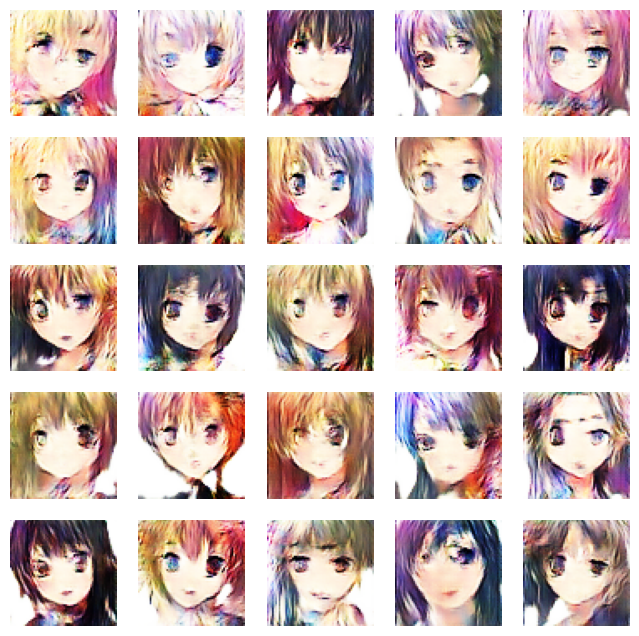

674/674 ━━━━━━━━━━━━━━━━━━━━ 780s 1s/step - d_loss: 0.6097 - g_loss: 1.3189
Epoch 12/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6418 - g_loss: 1.1584

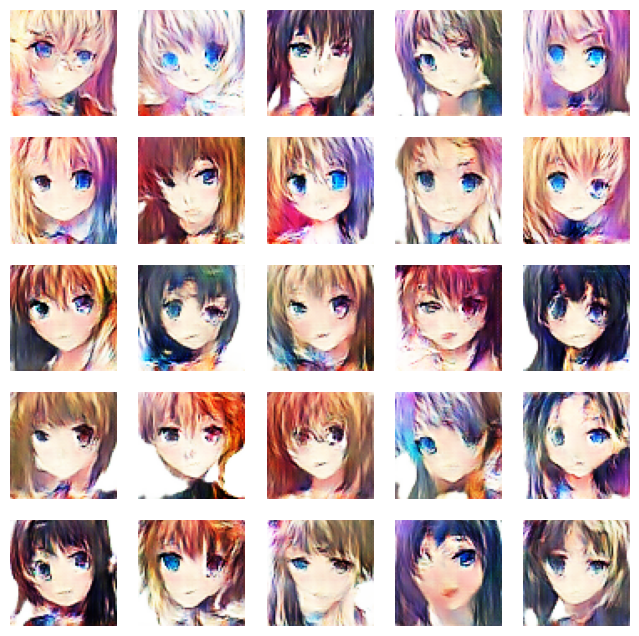

674/674 ━━━━━━━━━━━━━━━━━━━━ 769s 1s/step - d_loss: 0.6419 - g_loss: 1.1584
Epoch 13/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6406 - g_loss: 1.1326

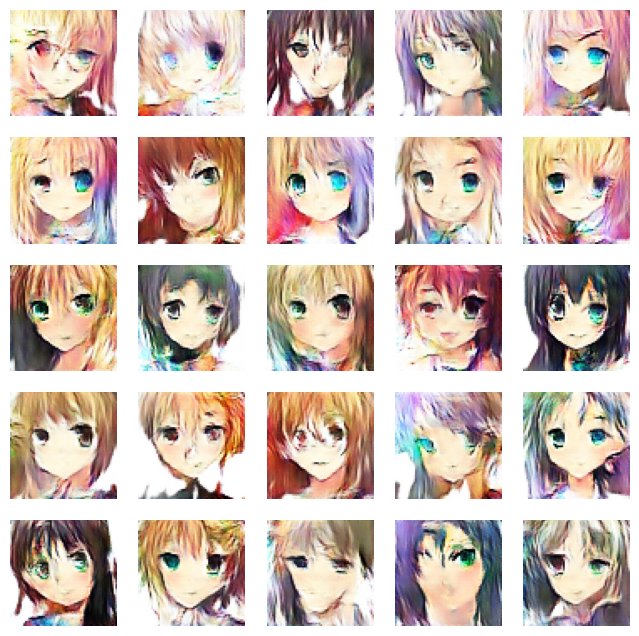

674/674 ━━━━━━━━━━━━━━━━━━━━ 800s 1s/step - d_loss: 0.6406 - g_loss: 1.1326
Epoch 14/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6420 - g_loss: 1.1014

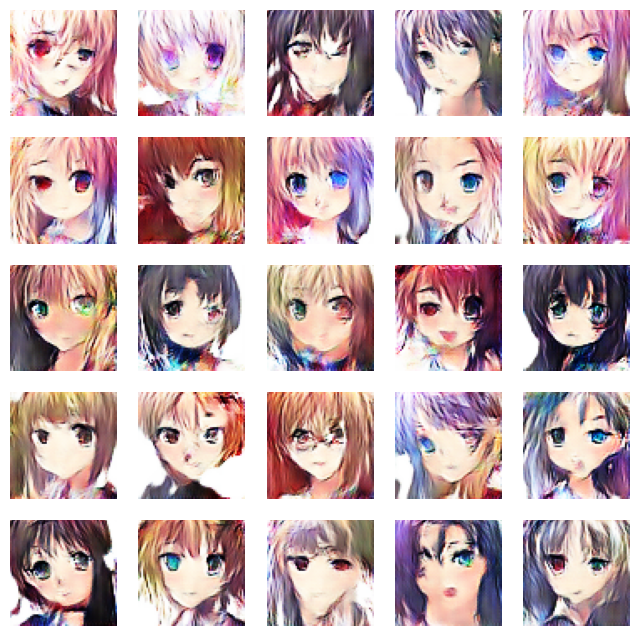

674/674 ━━━━━━━━━━━━━━━━━━━━ 799s 1s/step - d_loss: 0.6420 - g_loss: 1.1013
Epoch 15/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6572 - g_loss: 1.0600

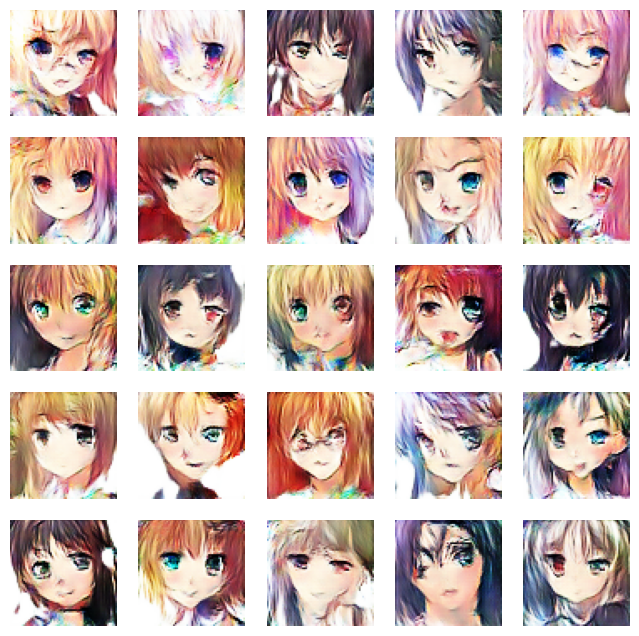

674/674 ━━━━━━━━━━━━━━━━━━━━ 844s 1s/step - d_loss: 0.6572 - g_loss: 1.0600
Epoch 16/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6551 - g_loss: 1.0313

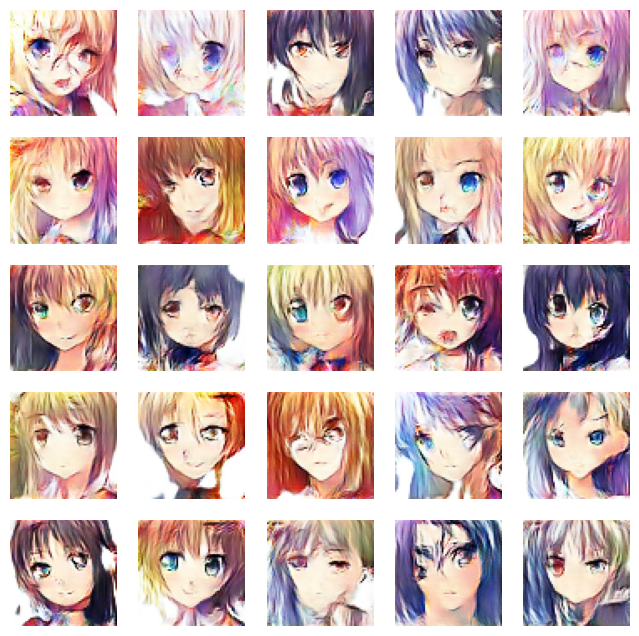

674/674 ━━━━━━━━━━━━━━━━━━━━ 880s 1s/step - d_loss: 0.6551 - g_loss: 1.0313
Epoch 17/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6643 - g_loss: 0.9996

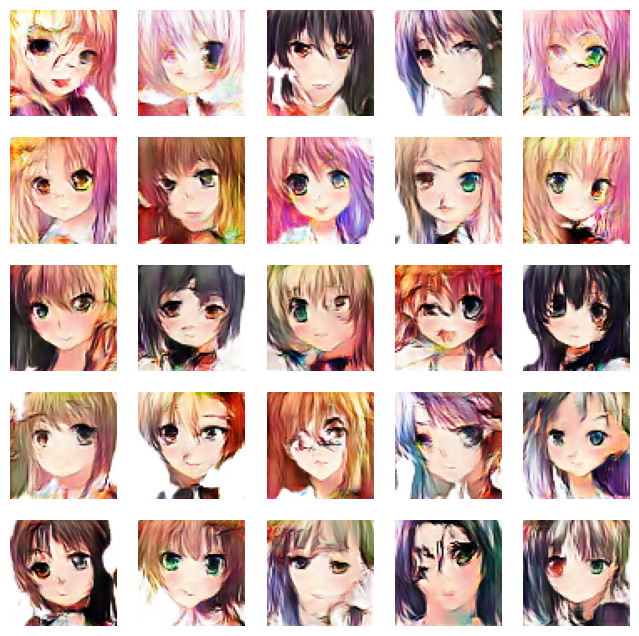

674/674 ━━━━━━━━━━━━━━━━━━━━ 821s 1s/step - d_loss: 0.6643 - g_loss: 0.9996
Epoch 18/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6568 - g_loss: 0.9972

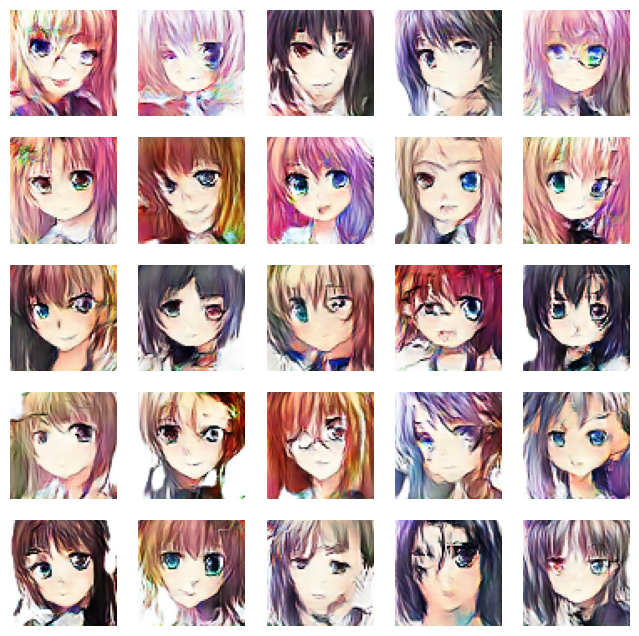

674/674 ━━━━━━━━━━━━━━━━━━━━ 781s 1s/step - d_loss: 0.6568 - g_loss: 0.9972
Epoch 19/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6567 - g_loss: 0.9916

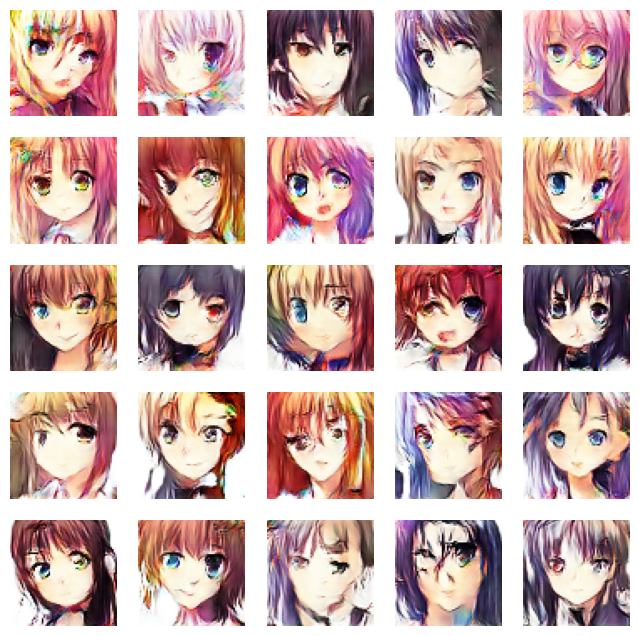

674/674 ━━━━━━━━━━━━━━━━━━━━ 777s 1s/step - d_loss: 0.6567 - g_loss: 0.9916
Epoch 20/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6569 - g_loss: 0.9864

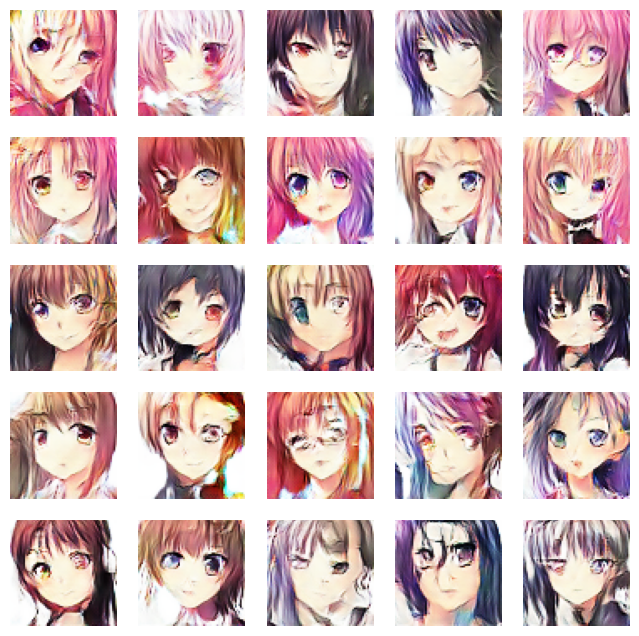

674/674 ━━━━━━━━━━━━━━━━━━━━ 828s 1s/step - d_loss: 0.6569 - g_loss: 0.9864
Epoch 21/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6548 - g_loss: 0.9747

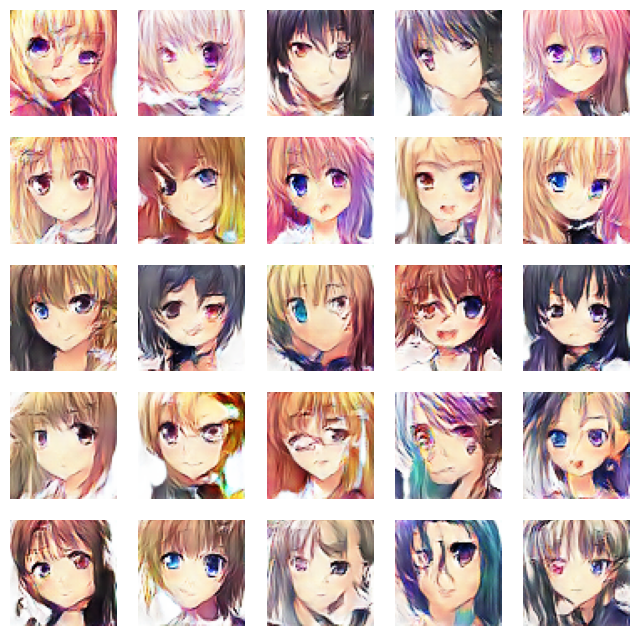

674/674 ━━━━━━━━━━━━━━━━━━━━ 791s 1s/step - d_loss: 0.6548 - g_loss: 0.9747
Epoch 22/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6547 - g_loss: 0.9729

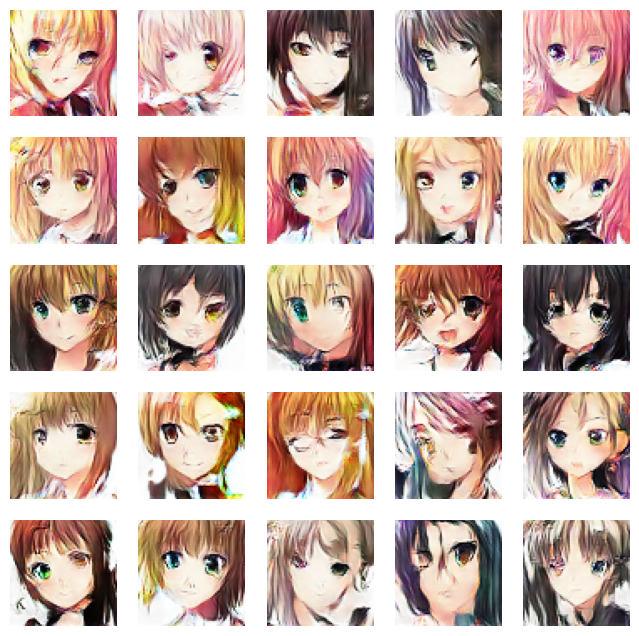

674/674 ━━━━━━━━━━━━━━━━━━━━ 871s 1s/step - d_loss: 0.6547 - g_loss: 0.9729
Epoch 23/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6545 - g_loss: 0.9721

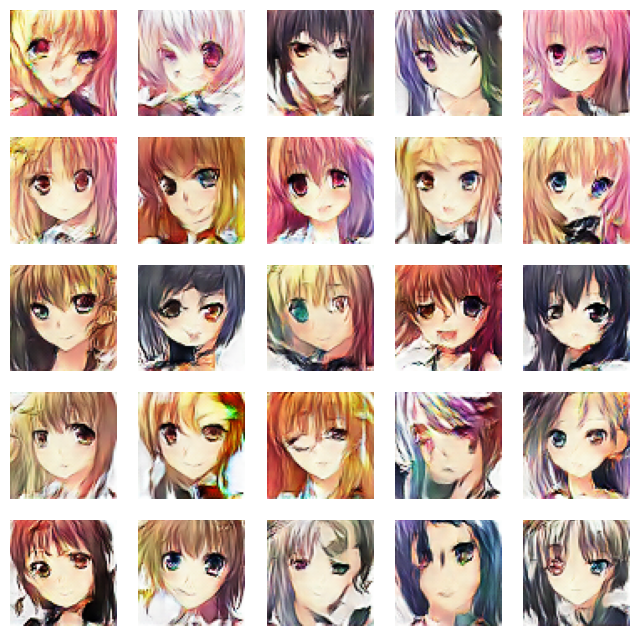

674/674 ━━━━━━━━━━━━━━━━━━━━ 813s 1s/step - d_loss: 0.6545 - g_loss: 0.9721
Epoch 24/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6501 - g_loss: 0.9673

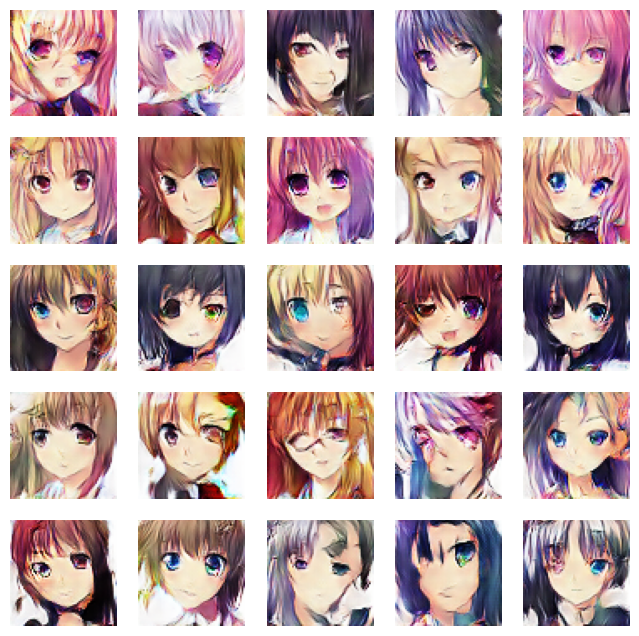

674/674 ━━━━━━━━━━━━━━━━━━━━ 781s 1s/step - d_loss: 0.6501 - g_loss: 0.9673
Epoch 25/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6489 - g_loss: 0.9661

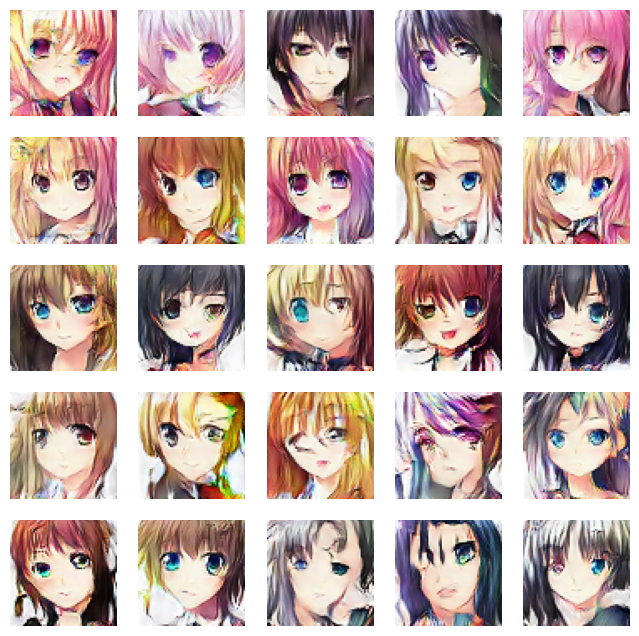

674/674 ━━━━━━━━━━━━━━━━━━━━ 779s 1s/step - d_loss: 0.6489 - g_loss: 0.9661
Epoch 26/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6472 - g_loss: 0.9692

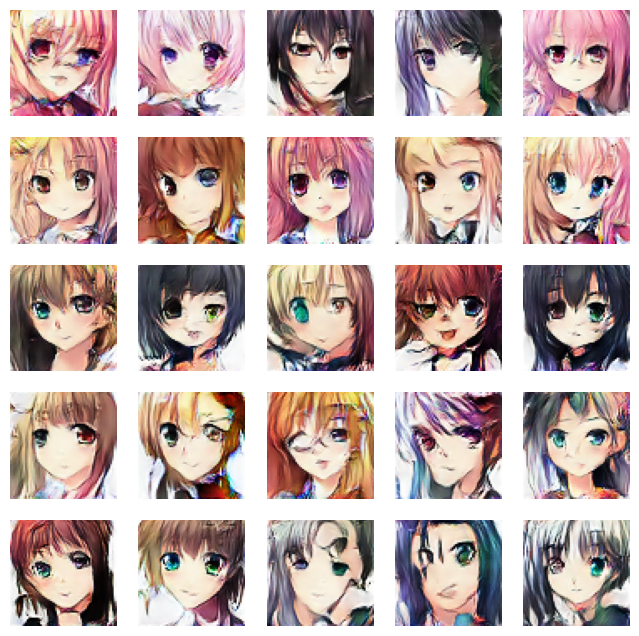

674/674 ━━━━━━━━━━━━━━━━━━━━ 781s 1s/step - d_loss: 0.6472 - g_loss: 0.9692
Epoch 27/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6403 - g_loss: 0.9748

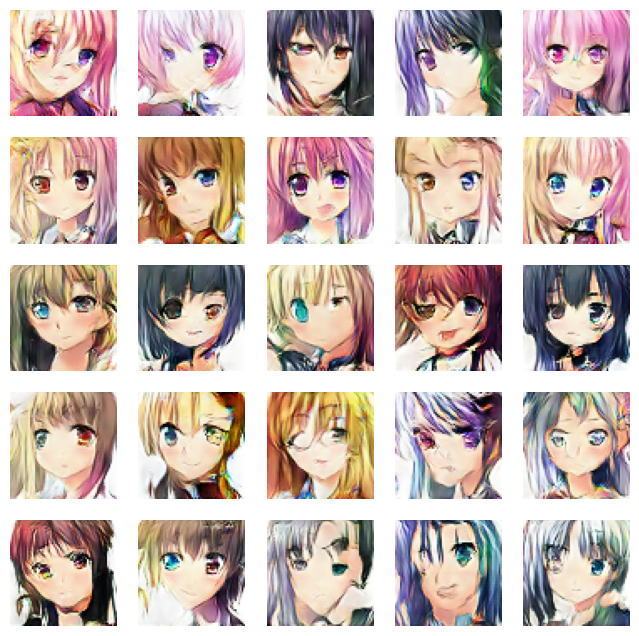

674/674 ━━━━━━━━━━━━━━━━━━━━ 783s 1s/step - d_loss: 0.6403 - g_loss: 0.9748
Epoch 28/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6346 - g_loss: 0.9900

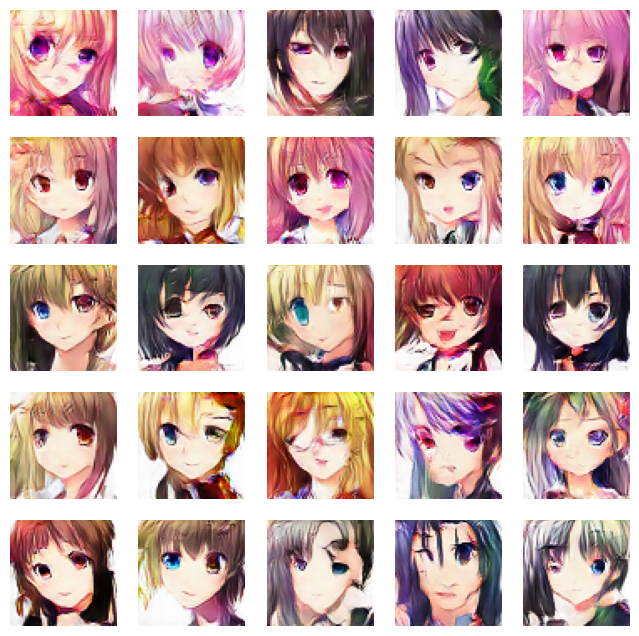

674/674 ━━━━━━━━━━━━━━━━━━━━ 790s 1s/step - d_loss: 0.6346 - g_loss: 0.9900
Epoch 29/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6343 - g_loss: 0.9963

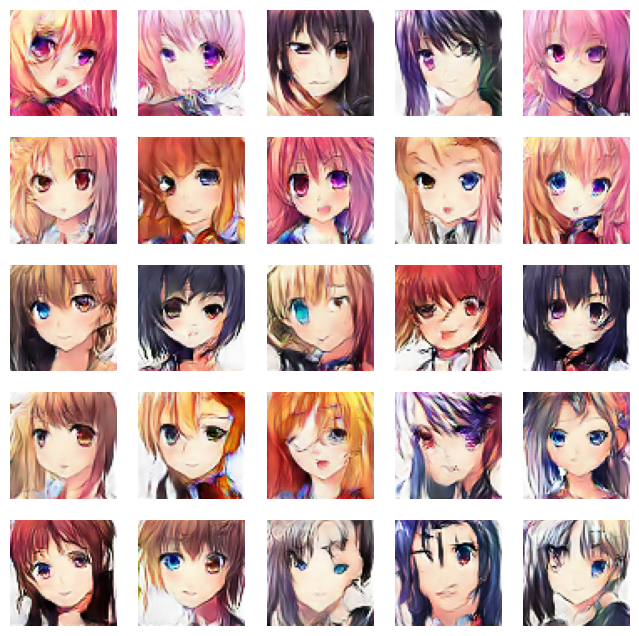

674/674 ━━━━━━━━━━━━━━━━━━━━ 789s 1s/step - d_loss: 0.6343 - g_loss: 0.9963
Epoch 30/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6297 - g_loss: 1.0045

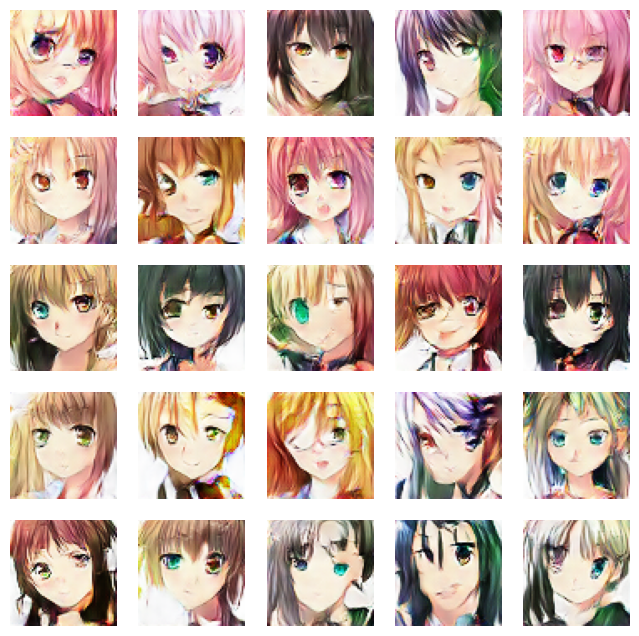

674/674 ━━━━━━━━━━━━━━━━━━━━ 778s 1s/step - d_loss: 0.6298 - g_loss: 1.0045
Epoch 31/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6275 - g_loss: 1.0020

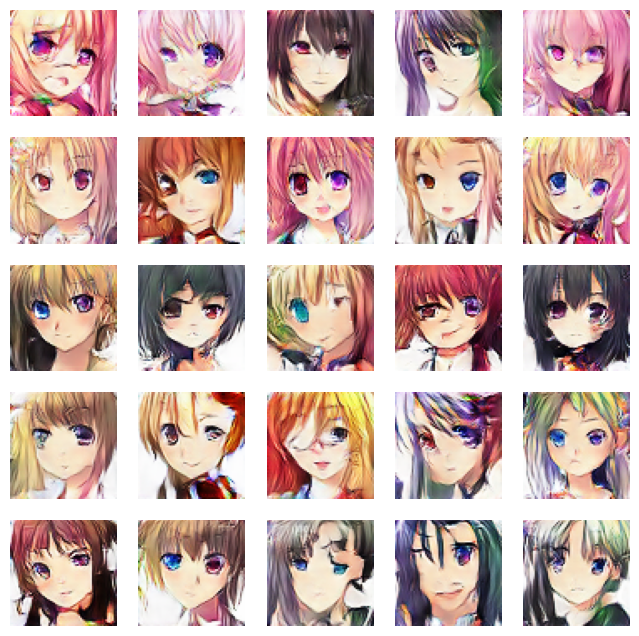

674/674 ━━━━━━━━━━━━━━━━━━━━ 819s 1s/step - d_loss: 0.6275 - g_loss: 1.0020
Epoch 32/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6259 - g_loss: 1.0037

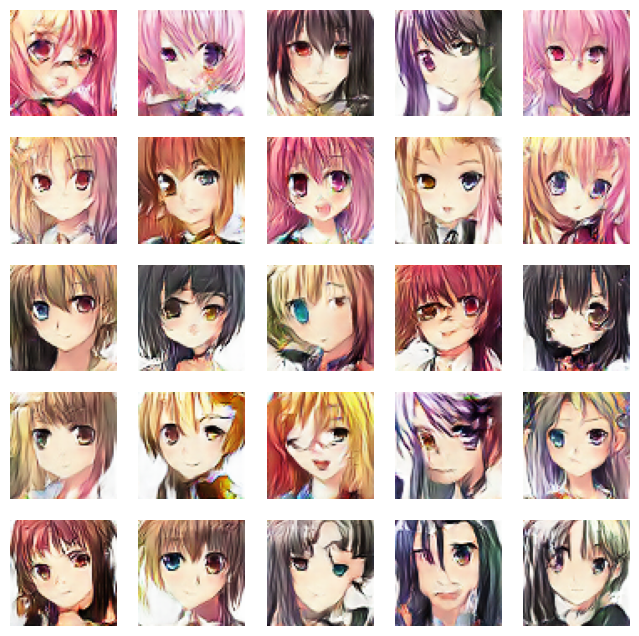

674/674 ━━━━━━━━━━━━━━━━━━━━ 789s 1s/step - d_loss: 0.6259 - g_loss: 1.0037
Epoch 33/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6225 - g_loss: 1.0178

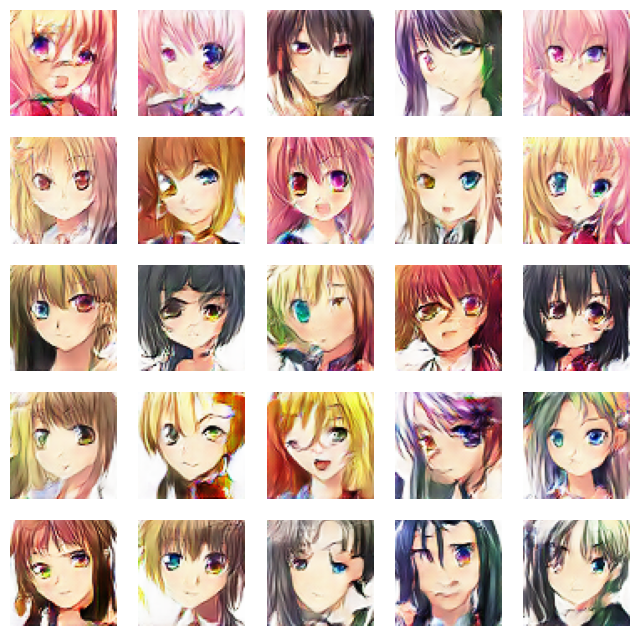

674/674 ━━━━━━━━━━━━━━━━━━━━ 789s 1s/step - d_loss: 0.6225 - g_loss: 1.0178
Epoch 34/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6182 - g_loss: 1.0287

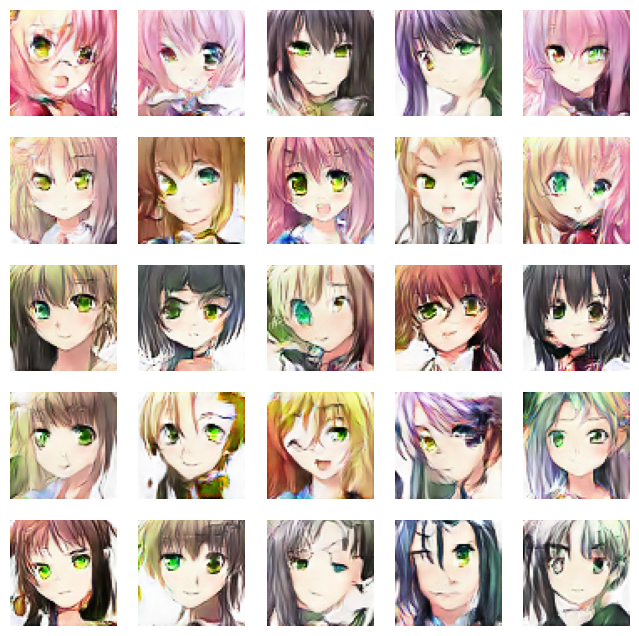

674/674 ━━━━━━━━━━━━━━━━━━━━ 797s 1s/step - d_loss: 0.6182 - g_loss: 1.0287
Epoch 35/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6153 - g_loss: 1.0334

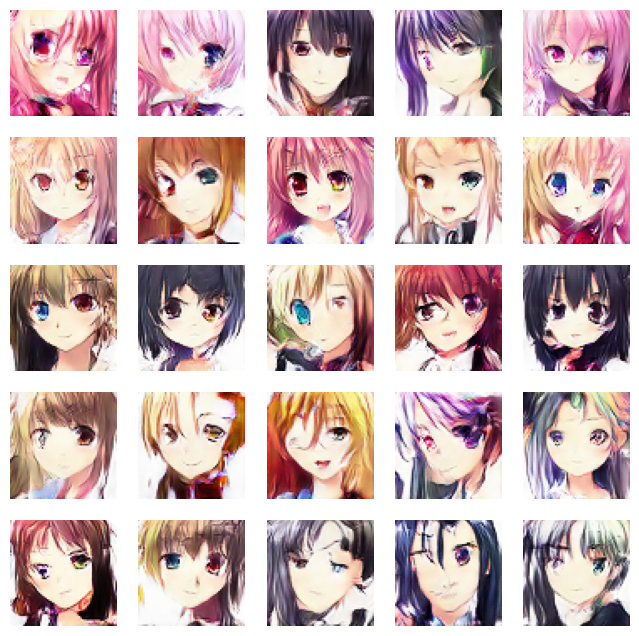

674/674 ━━━━━━━━━━━━━━━━━━━━ 789s 1s/step - d_loss: 0.6153 - g_loss: 1.0334
Epoch 36/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6075 - g_loss: 1.0531

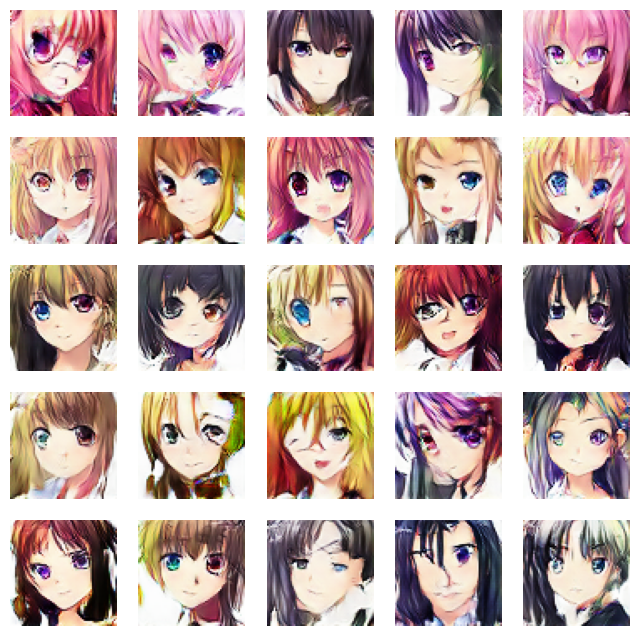

674/674 ━━━━━━━━━━━━━━━━━━━━ 799s 1s/step - d_loss: 0.6075 - g_loss: 1.0531
Epoch 37/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6151 - g_loss: 1.0491

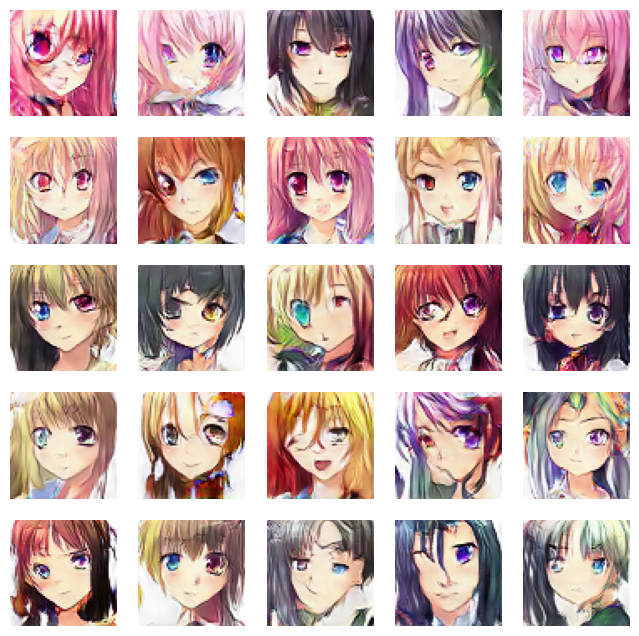

674/674 ━━━━━━━━━━━━━━━━━━━━ 794s 1s/step - d_loss: 0.6151 - g_loss: 1.0491
Epoch 38/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6052 - g_loss: 1.0654

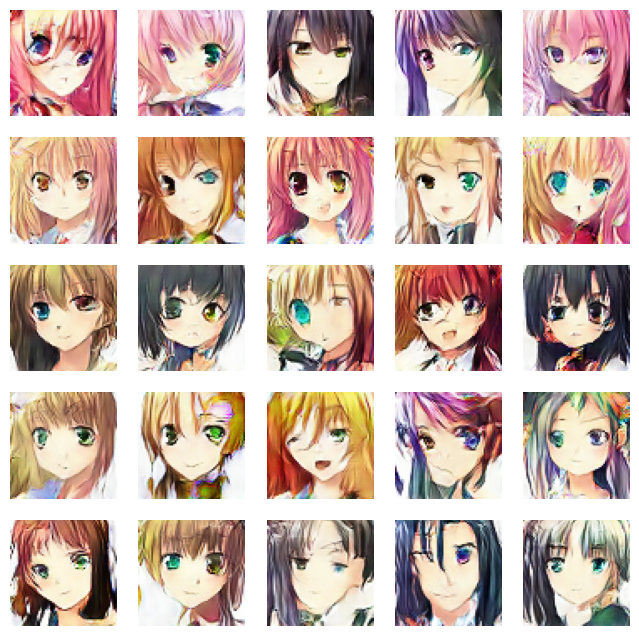

674/674 ━━━━━━━━━━━━━━━━━━━━ 817s 1s/step - d_loss: 0.6052 - g_loss: 1.0654
Epoch 39/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6029 - g_loss: 1.0732

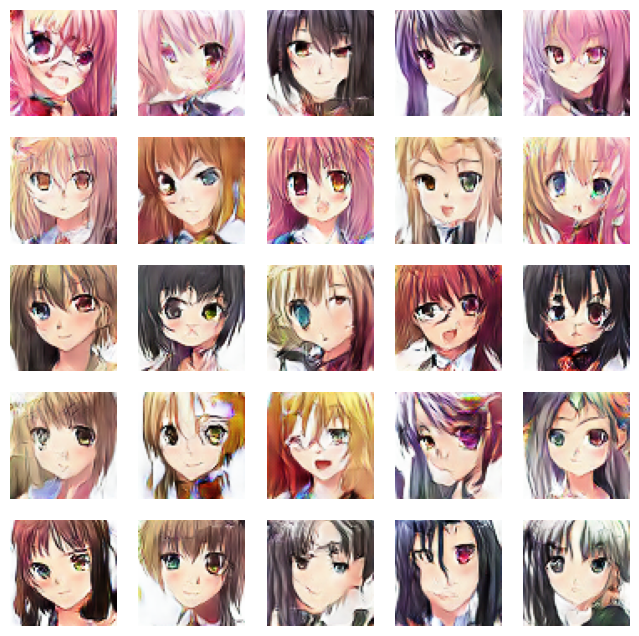

674/674 ━━━━━━━━━━━━━━━━━━━━ 799s 1s/step - d_loss: 0.6029 - g_loss: 1.0732
Epoch 40/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5992 - g_loss: 1.0975

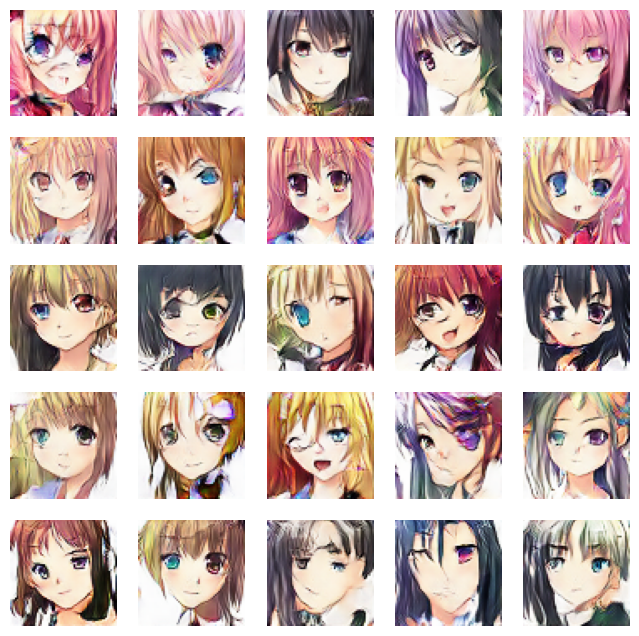

674/674 ━━━━━━━━━━━━━━━━━━━━ 799s 1s/step - d_loss: 0.5992 - g_loss: 1.0975
Epoch 41/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5884 - g_loss: 1.1013

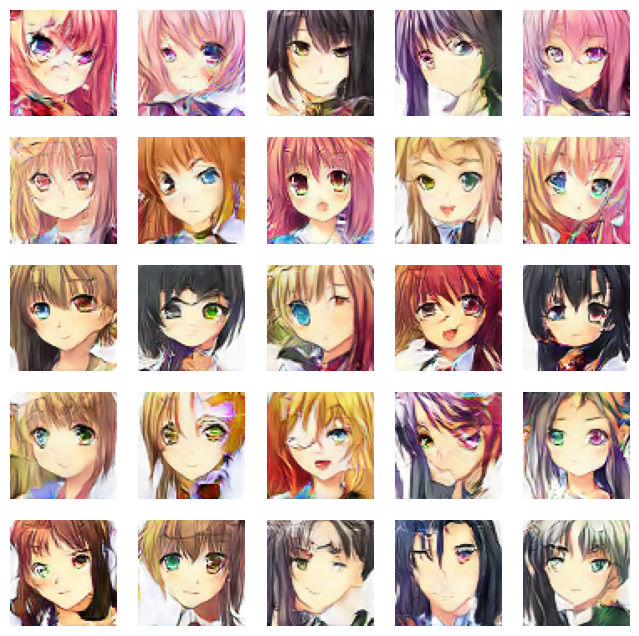

674/674 ━━━━━━━━━━━━━━━━━━━━ 790s 1s/step - d_loss: 0.5884 - g_loss: 1.1014
Epoch 42/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5869 - g_loss: 1.1327

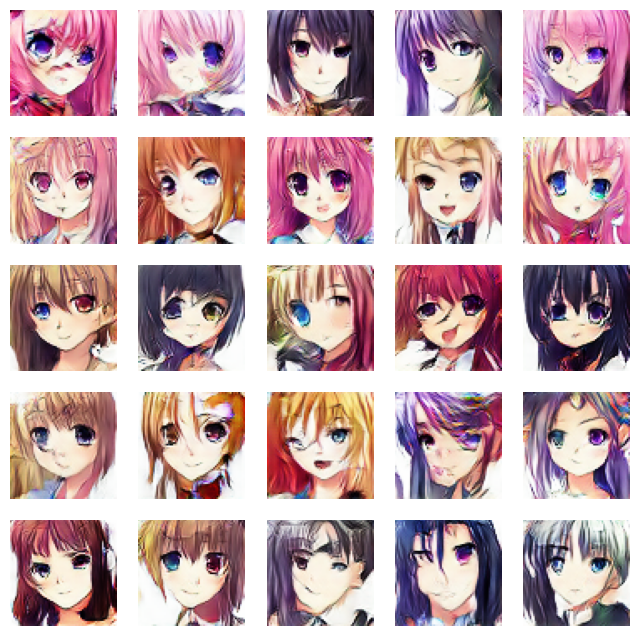

674/674 ━━━━━━━━━━━━━━━━━━━━ 787s 1s/step - d_loss: 0.5869 - g_loss: 1.1327
Epoch 43/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5841 - g_loss: 1.1293

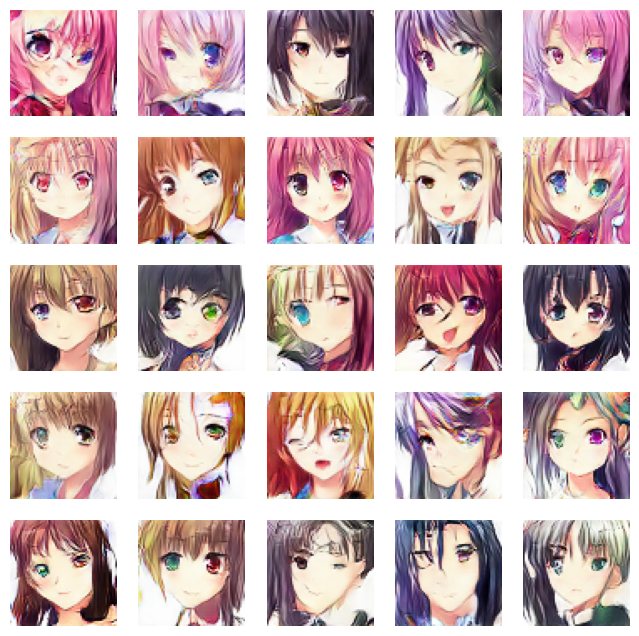

674/674 ━━━━━━━━━━━━━━━━━━━━ 789s 1s/step - d_loss: 0.5841 - g_loss: 1.1293
Epoch 44/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5769 - g_loss: 1.1448

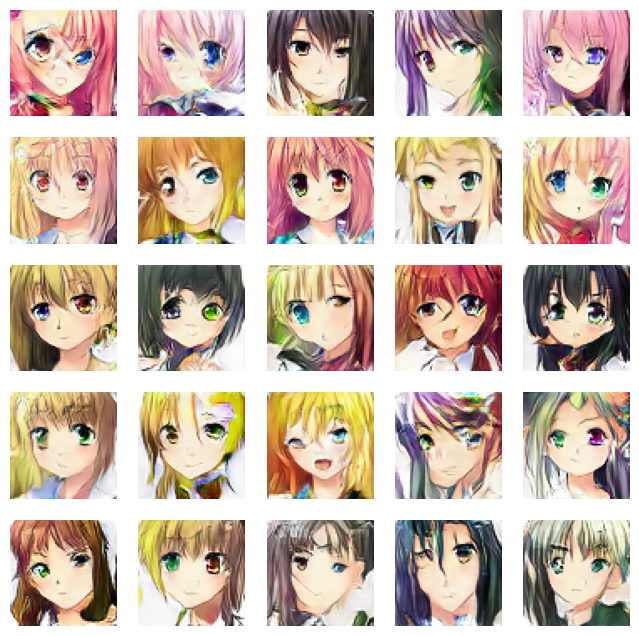

674/674 ━━━━━━━━━━━━━━━━━━━━ 797s 1s/step - d_loss: 0.5769 - g_loss: 1.1448
Epoch 45/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5770 - g_loss: 1.1616

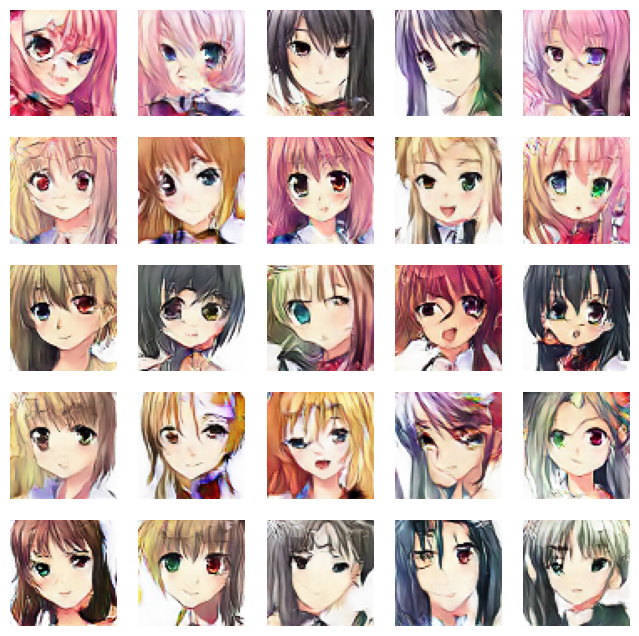

674/674 ━━━━━━━━━━━━━━━━━━━━ 809s 1s/step - d_loss: 0.5770 - g_loss: 1.1616
Epoch 46/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5727 - g_loss: 1.1814

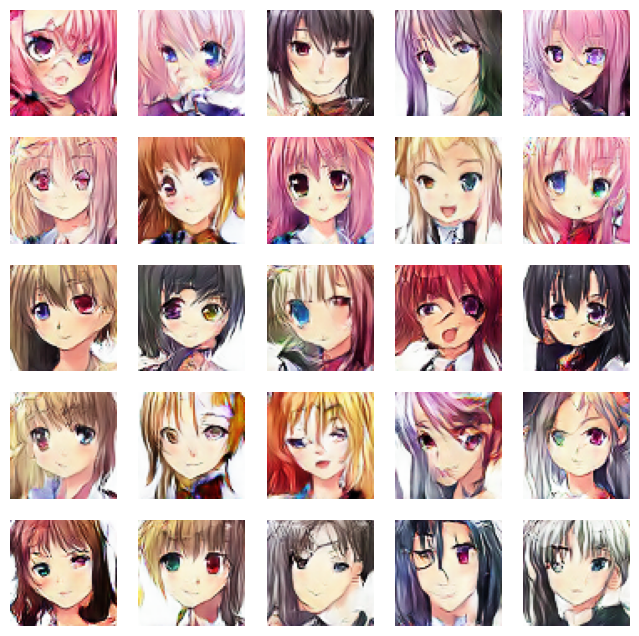

674/674 ━━━━━━━━━━━━━━━━━━━━ 832s 1s/step - d_loss: 0.5727 - g_loss: 1.1814
Epoch 47/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5623 - g_loss: 1.2095

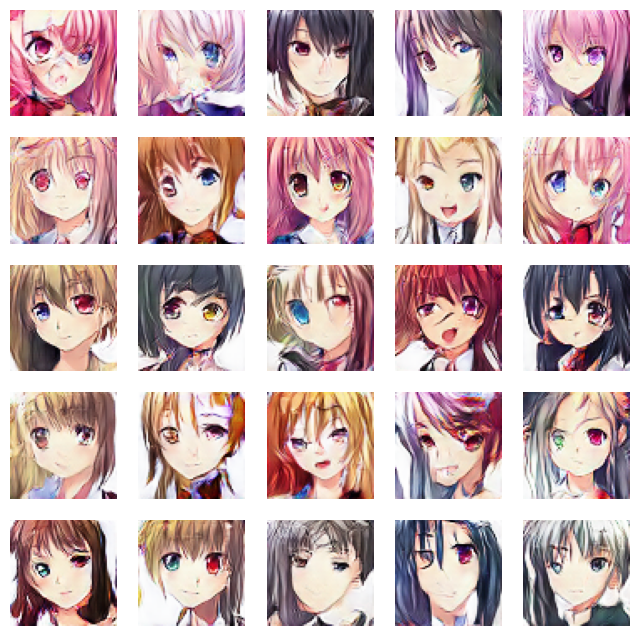

674/674 ━━━━━━━━━━━━━━━━━━━━ 824s 1s/step - d_loss: 0.5623 - g_loss: 1.2095
Epoch 48/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5682 - g_loss: 1.2085

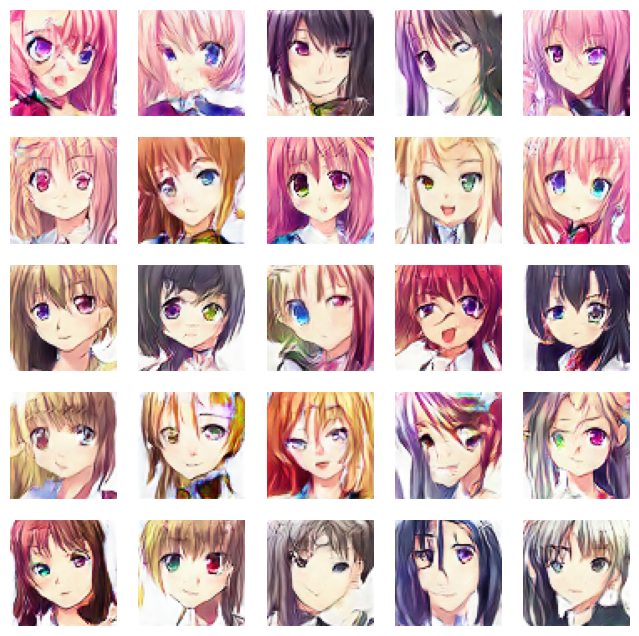

674/674 ━━━━━━━━━━━━━━━━━━━━ 821s 1s/step - d_loss: 0.5682 - g_loss: 1.2085
Epoch 49/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5529 - g_loss: 1.2328

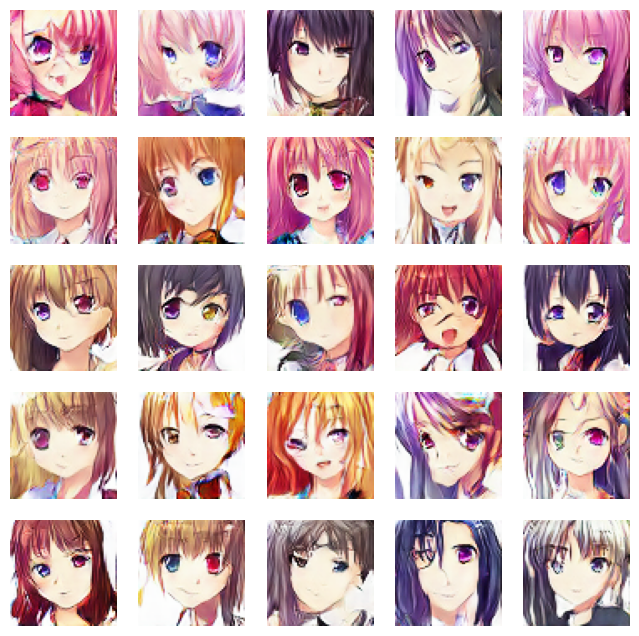

674/674 ━━━━━━━━━━━━━━━━━━━━ 841s 1s/step - d_loss: 0.5529 - g_loss: 1.2328
Epoch 50/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.5553 - g_loss: 1.2429

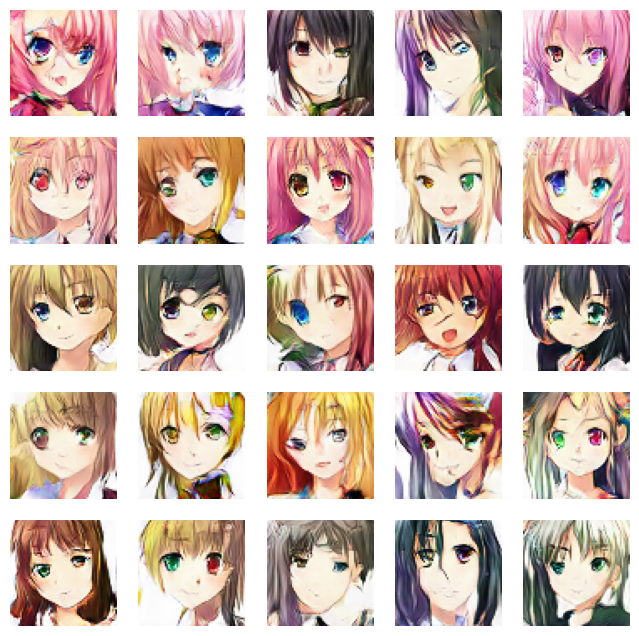

674/674 ━━━━━━━━━━━━━━━━━━━━ 827s 1s/step - d_loss: 0.5553 - g_loss: 1.2429


In [20]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

## Generate New Anime Image

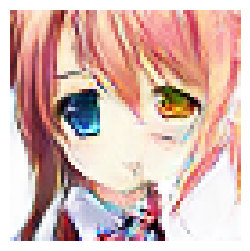

In [22]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()

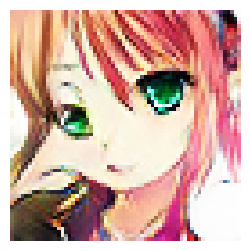

In [25]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()